In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import Image, display, HTML
from humanfriendly import format_timespan, format_number, format_length
import folium
import gpxpy
import gzip
import io
import zlib
import fitparse
import os

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
df = pd.read_csv('activities.csv')

In [4]:
df.head()

,Activity ID,Activity Date,Activity Name,Activity Type,Activity Description,Elapsed Time,Distance,Max Heart Rate,Relative Effort,Commute,Activity Private Note,Activity Gear,Filename,Athlete Weight,Bike Weight,Elapsed Time.1,Moving Time,Distance.1,Max Speed,Average Speed,Elevation Gain,Elevation Loss,Elevation Low,Elevation High,Max Grade,Average Grade,Average Positive Grade,Average Negative Grade,Max Cadence,Average Cadence,Max Heart Rate.1,Average Heart Rate,Max Watts,Average Watts,Calories,Max Temperature,Average Temperature,Relative Effort.1,Total Work,Number of Runs,Uphill Time,Downhill Time,Other Time,Perceived Exertion,"<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.type"">Type</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.start_time"">Start Time</span>",Weighted Average Power,Power Count,Prefer Perceived Exertion,Perceived Relative Effort,Commute.1,Total Weight Lifted,From Upload,Grade Adjusted Distance,Weather Observation Time,Weather Condition,Weather Temperature,Apparent Temperature,Dewpoint,Humidity,Weather Pressure,Wind Speed,Wind Gust,Wind Bearing,Precipitation Intensity,Sunrise Time,Sunset Time,Moon Phase,Bike,Gear,Precipitation Probability,Precipitation Type,Cloud Cover,Weather Visibility,UV Index,Weather Ozone,"<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.jump_count"">Jump Count</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.total_grit"">Total Grit</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.avg_flow"">Avg Flow</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.flagged"">Flagged</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.avg_elapsed_speed"">Avg Elapsed Speed</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.dirt_distance"">Dirt Distance</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.newly_explored_distance"">Newly Explored Distance</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.newly_explored_dirt_distance"">Newly Explored Dirt Distance</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.sport_type"">Sport Type</span>","<span class=""translation_missing"" title=""translation missing: en-US.lib.export.portability_exporter.activities.horton_values.total_steps"">Total Steps</span>",Media
0,178320385,"Aug 10, 2014, 4:36:48 PM",Evening Walk,Walk,NaN,29,0.14,NaN,NaN,False,NaN,NaN,activities/178320385.gpx,100.0,NaN,29.0,29.0,145.699997,11.1,NaN,0.000000,NaN,12.5,12.700000,1.4,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.901867,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,178364464,"Aug 10, 2014, 5:07:20 PM",Evening Ride,Ride,NaN,2792,13.70,NaN,NaN,False,NaN,NaN,activities/178364464.gpx,100.0,NaN,2792.0,2770.0,13702.299805,12.2,NaN,25.985701,35.685699,-2.0,25.799999,7.6,-0.070791,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10920.20019

In [5]:
df.columns

Index(['Activity ID', 'Activity Date', 'Activity Name', 'Activity Type',
       'Activity Description', 'Elapsed Time', 'Distance', 'Max Heart Rate',
       'Relative Effort', 'Commute', 'Activity Private Note', 'Activity Gear',
       'Filename', 'Athlete Weight', 'Bike Weight', 'Elapsed Time.1',
       'Moving Time', 'Distance.1', 'Max Speed', 'Average Speed',
       'Elevation Gain', 'Elevation Loss', 'Elevation Low', 'Elevation High',
       'Max Grade', 'Average Grade', 'Average Positive Grade',
       'Average Negative Grade', 'Max Cadence', 'Average Cadence',
       'Max Heart Rate.1', 'Average Heart Rate', 'Max Watts', 'Average Watts',
       'Calories', 'Max Temperature', 'Average Temperature',
       'Relative Effort.1', 'Total Work', 'Number of Runs', 'Uphill Time',
       'Downhill Time', 'Other Time', 'Perceived Exertion',
       '<span class="translation_missing" title="translation missing: en-US.lib.export.portability_exporter.activities.horton_values.type">Type</span>',

Nuimti html tagai iš stulpeliu indeksų.

In [6]:
df.columns = df.columns.str.replace(r'<[^<>]*>', '', regex=True)

In [7]:
df.columns

Index(['Activity ID', 'Activity Date', 'Activity Name', 'Activity Type',
       'Activity Description', 'Elapsed Time', 'Distance', 'Max Heart Rate',
       'Relative Effort', 'Commute', 'Activity Private Note', 'Activity Gear',
       'Filename', 'Athlete Weight', 'Bike Weight', 'Elapsed Time.1',
       'Moving Time', 'Distance.1', 'Max Speed', 'Average Speed',
       'Elevation Gain', 'Elevation Loss', 'Elevation Low', 'Elevation High',
       'Max Grade', 'Average Grade', 'Average Positive Grade',
       'Average Negative Grade', 'Max Cadence', 'Average Cadence',
       'Max Heart Rate.1', 'Average Heart Rate', 'Max Watts', 'Average Watts',
       'Calories', 'Max Temperature', 'Average Temperature',
       'Relative Effort.1', 'Total Work', 'Number of Runs', 'Uphill Time',
       'Downhill Time', 'Other Time', 'Perceived Exertion', 'Type',
       'Start Time', 'Weighted Average Power', 'Power Count',
       'Prefer Perceived Exertion', 'Perceived Relative Effort', 'Commute.1',
    

In [8]:
df.isna().sum()

Activity ID                        0
Activity Date                      0
Activity Name                      0
Activity Type                      0
Activity Description            3079
                                ... 
Newly Explored Distance         4050
Newly Explored Dirt Distance    4050
Sport Type                      4050
Total Steps                     4050
Media                           3527
Length: 87, dtype: int64

In [9]:
df = df.dropna(axis=1, how='all')

In [10]:
df.columns

Index(['Activity ID', 'Activity Date', 'Activity Name', 'Activity Type',
       'Activity Description', 'Elapsed Time', 'Distance', 'Max Heart Rate',
       'Relative Effort', 'Commute', 'Activity Gear', 'Filename',
       'Athlete Weight', 'Bike Weight', 'Elapsed Time.1', 'Moving Time',
       'Distance.1', 'Max Speed', 'Average Speed', 'Elevation Gain',
       'Elevation Loss', 'Elevation Low', 'Elevation High', 'Max Grade',
       'Average Grade', 'Max Cadence', 'Average Cadence', 'Max Heart Rate.1',
       'Average Heart Rate', 'Average Watts', 'Calories',
       'Average Temperature', 'Relative Effort.1', 'Perceived Exertion',
       'Prefer Perceived Exertion', 'Perceived Relative Effort', 'Commute.1',
       'From Upload', 'Grade Adjusted Distance', 'Weather Observation Time',
       'Weather Condition', 'Weather Temperature', 'Apparent Temperature',
       'Dewpoint', 'Humidity', 'Weather Pressure', 'Wind Speed', 'Wind Gust',
       'Wind Bearing', 'Precipitation Intensity', 'S

In [11]:
df.head()

,Activity ID,Activity Date,Activity Name,Activity Type,Activity Description,Elapsed Time,Distance,Max Heart Rate,Relative Effort,Commute,Activity Gear,Filename,Athlete Weight,Bike Weight,Elapsed Time.1,Moving Time,Distance.1,Max Speed,Average Speed,Elevation Gain,Elevation Loss,Elevation Low,Elevation High,Max Grade,Average Grade,Max Cadence,Average Cadence,Max Heart Rate.1,Average Heart Rate,Average Watts,Calories,Average Temperature,Relative Effort.1,Perceived Exertion,Prefer Perceived Exertion,Perceived Relative Effort,Commute.1,From Upload,Grade Adjusted Distance,Weather Observation Time,Weather Condition,Weather Temperature,Apparent Temperature,Dewpoint,Humidity,Weather Pressure,Wind Speed,Wind Gust,Wind Bearing,Precipitation Intensity,Sunrise Time,Sunset Time,Moon Phase,Bike,Precipitation Probability,Precipitation Type,Cloud Cover,Weather Visibility,UV Index,Weather Ozone,Flagged,Avg Elapsed Speed,Dirt Distance,Media
0,178320385,"Aug 10, 2014, 4:36:48 PM",Evening Walk,Walk,NaN,29,0.14,NaN,NaN,False,NaN,activities/178320385.gpx,100.0,NaN,29.0,29.0,145.699997,11.1,NaN,0.000000,NaN,12.5,12.700000,1.4,0.000000,NaN,NaN,NaN,NaN,NaN,17.901867,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,178364464,"Aug 10, 2014, 5:07:20 PM",Evening Ride,Ride,NaN,2792,13.70,NaN,NaN,False,NaN,activities/178364464.gpx,100.0,NaN,2792.0,2770.0,13702.299805,12.2,NaN,25.985701,35.685699,-2.0,25.799999,7.6,-0.070791,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10920.200195,NaN
2,178374420,"Aug 10, 2014, 1:44:06 PM","08/10/2014 Klaipėda, Klaipedos Apskritis, Lith...",Ride,NaN,4257,18.65,NaN,NaN,False,NaN,activities/195797812.gpx.gz,100.0,NaN,4257.0,3330.0,18656.400391,10.7,NaN,29.240000,18.040001,-1.7,25.400000,7.5,0.060033,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13167.400391,NaN
3,178377613,"Aug 9, 2014, 9:20:19 PM","08/10/2014 Klaipėda, Klaipedos Apskritis, Lith...",Ride,NaN,4070,21.79,NaN,NaN,False,NaN,activities/195801446.gpx.gz,100.0,NaN,4070.0,3856.0,21789.599609,9.7,NaN,21.160000,32.259998,-1.0,30.900000,14.7,-0.050942,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3748.300049,NaN
4,178378375,"Aug 9, 2014, 7:04:29 PM","08/09/2014 Klaipėda, Klaipedos Apskritis, Lith...",Ride,NaN,7885,20.59,NaN,NaN,False,NaN,activities/195802289.gpx.gz,100.0,NaN,7885.0,3670.0,20593.000000,11.4,NaN,34.433300,25.533300,7.6,34.599998,3.8,0.043219,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1394.500000,NaN


In [12]:
cols = df.columns.values.tolist()

In [13]:
for k, v in enumerate(cols):
    print(k, v)

0 Activity ID
1 Activity Date
2 Activity Name
3 Activity Type
4 Activity Description
5 Elapsed Time
6 Distance
7 Max Heart Rate
8 Relative Effort
9 Commute
10 Activity Gear
11 Filename
12 Athlete Weight
13 Bike Weight
14 Elapsed Time.1
15 Moving Time
16 Distance.1
17 Max Speed
18 Average Speed
19 Elevation Gain
20 Elevation Loss
21 Elevation Low
22 Elevation High
23 Max Grade
24 Average Grade
25 Max Cadence
26 Average Cadence
27 Max Heart Rate.1
28 Average Heart Rate
29 Average Watts
30 Calories
31 Average Temperature
32 Relative Effort.1
33 Perceived Exertion
34 Prefer Perceived Exertion
35 Perceived Relative Effort
36 Commute.1
37 From Upload
38 Grade Adjusted Distance
39 Weather Observation Time
40 Weather Condition
41 Weather Temperature
42 Apparent Temperature
43 Dewpoint
44 Humidity
45 Weather Pressure
46 Wind Speed
47 Wind Gust
48 Wind Bearing
49 Precipitation Intensity
50 Sunrise Time
51 Sunset Time
52 Moon Phase
53 Bike
54 Precipitation Probability
55 Precipitation Type
56 Clo

Converting date from string to datetime 

df['activity_date'] = pd.to_datetime(df['Activity Date'], infer_datetime_format=True - meta įspėjimą)

In [14]:
# Decorated 'Average Speed', 'Max Speed', Activity Date, 'Moving Time'
df['average_speed'] = df['Average Speed'].apply(lambda x: str(round((x*60*60/1000), 2)))
df['max_speed'] = df['Max Speed'].apply(lambda x: str(round((x*60*60/1000), 2)))
df['moving_time'] = df['Moving Time'].apply(lambda x: format_timespan(x))
df['activity_date'] = pd.to_datetime(df['Activity Date'], format='mixed')
df['elevation_gain'] = df['Elevation Gain'].apply(lambda x: round(x,2))

In [15]:
df['activity_date'].head()

0   2014-08-10 16:36:48
1   2014-08-10 17:07:20
2   2014-08-10 13:44:06
3   2014-08-09 21:20:19
4   2014-08-09 19:04:29
Name: activity_date, dtype: datetime64[ns]

In [16]:
# select date range in 2022
year_act = (df['activity_date'] >= '2022-01-01') & (df['activity_date'] <= '2022-12-31')
df = df.loc[year_act]
df.head()

,Activity ID,Activity Date,Activity Name,Activity Type,Activity Description,Elapsed Time,Distance,Max Heart Rate,Relative Effort,Commute,Activity Gear,Filename,Athlete Weight,Bike Weight,Elapsed Time.1,Moving Time,Distance.1,Max Speed,Average Speed,Elevation Gain,Elevation Loss,Elevation Low,Elevation High,Max Grade,Average Grade,Max Cadence,Average Cadence,Max Heart Rate.1,Average Heart Rate,Average Watts,Calories,Average Temperature,Relative Effort.1,Perceived Exertion,Prefer Perceived Exertion,Perceived Relative Effort,Commute.1,From Upload,Grade Adjusted Distance,Weather Observation Time,Weather Condition,Weather Temperature,Apparent Temperature,Dewpoint,Humidity,Weather Pressure,Wind Speed,Wind Gust,Wind Bearing,Precipitation Intensity,Sunrise Time,Sunset Time,Moon Phase,Bike,Precipitation Probability,Precipitation Type,Cloud Cover,Weather Visibility,UV Index,Weather Ozone,Flagged,Avg Elapsed Speed,Dirt Distance,Media,average_speed,max_speed,moving_time,activity_date,elevation_gain
3342,6463285994,"Jan 2, 2022, 7:39:38 PM",Get to da chaaaaappaaaaahhhh!,Ride,Activity name auto generated by https://www.Ba...,3692,20.99,NaN,NaN,False,Canyon Inflite Al,activities/6871992476.fit.gz,NaN,10.0,3692.0,3153.0,20997.990234,10.278028,6.659686,76.0,67.0,-4.400000,33.000000,7.894453,0.060006,NaN,NaN,NaN,NaN,122.832634,431.831085,4.0,NaN,NaN,NaN,NaN,0.0,1.0,NaN,1.641150e+09,5.0,4.49,0.85,4.49,1.00,999.000000,4.69,9.19,239.0,0.9310,1.641107e+09,1.641133e+09,0.00,5143659.0,0.69,5.0,1.00,6141.0,0.0,332.799988,0.0,5.687429,7.000000,NaN,23.97,37.0,52 minutes and 33 seconds,2022-01-02 19:39:38,76.0
3343,6464456622,"Jan 3, 2022, 5:12:10 AM",I am running away from my responsibilities. An...,Ride,https://www.Bandok.com - Give your activities ...,1918,10.24,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6873256215.fit.gz,NaN,10.0,1918.0,1918.0,10248.910156,7.964386,5.343540,31.0,22.0,50.599998,147.600006,3.743648,0.078057,NaN,NaN,NaN,NaN,184.156799,390.000000,6.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641186e+09,5.0,4.32,0.03,4.32,1.00,996.400024,6.00,8.95,287.0,0.4036,1.641193e+09,1.641219e+09,0.04,5567028.0,0.60,5.0,1.00,3471.0,0.0,355.899994,0.0,5.343540,4767.000000,NaN,19.24,28.67,31 minutes and 58 seconds,2022-01-03 05:12:10,31.0
3344,6466969824,"Jan 3, 2022, 3:34:40 PM","Some people have no idea what they're doing, a...",Ride,https://www.Bandok.com - Give your activities ...,3080,10.61,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6875961489.fit.gz,NaN,10.0,3080.0,2362.0,10615.440430,7.631673,4.494259,32.0,32.0,9.800000,115.000000,14.218155,-0.039565,NaN,NaN,NaN,NaN,135.194229,370.000000,4.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641222e+09,5.0,4.48,0.90,3.58,0.94,997.599976,4.57,8.91,254.0,0.3824,1.641193e+09,1.641219e+09,0.04,5567028.0,0.42,5.0,1.00,16093.0,0.0,377.700012,0.0,3.446572,4861.600098,NaN,16.18,27.47,39 minutes and 22 seconds,2022-01-03 15:34:40,32.0
3345,6469567160,"Jan 4, 2022, 5:09:06 AM","The day you stop racing, is the day you win th...",Ride,https://www.Bandok.com - Give your activities ...,1950,9.46,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6878729766.fit.gz,NaN,10.0,1950.0,1713.0,9464.620117,9.262234,5.525172,36.0,29.0,22.000000,83.599998,23.230223,0.031697,NaN,NaN,NaN,NaN,197.504089,395.000000,5.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641272e+09,5.0,4.48,-0.73,4.48,1.00,995.299988,8.71,12.42,237.0,0.2484,1.641280e+09,1.641306e+09,0.08,5567028.0,0.45,5.0,0.97,16093.0,0.0,353.600006,0.0,4.853652,5083.100098,NaN,19.89,33.34,28 minutes and 33 seconds,2022-01-04 05:09:06,36.0
3346,6471805022,"Jan 4, 2022, 3:18:52 PM","To the winch, wench!",Ride,https://www.Bandok.com - Give your activities ...,2082,10.78,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6881153023.fit.gz,NaN,10.0,2082.0,2017.0,10782.900391,8.870002,5.346009,25.0,23.0,8.400000,99.199997,37.698254,-0.020403,NaN,NaN,NaN,NaN,177.334366,422.000000,4.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641308e+09,3.0,3.81,-0.77,2.61,0.92,992.700012,6.36,9.78,210.0,0.0661,1.6412

In [17]:
# number of activities
len(df)

617

In [18]:
df.groupby(['Activity Type']).size()

Activity Type
Ride    553
Walk     64
dtype: int64

In [19]:
df.groupby("Activity Type")["Distance"].sum()

Activity Type
Ride    13655.15
Walk      414.24
Name: Distance, dtype: float64

In [20]:
# Perform the groupby
activity_counts = df["Activity Type"].value_counts()

In [21]:
# Perform the groupby and sum operation
grouped = df.groupby("Activity Type")["Distance"].sum()

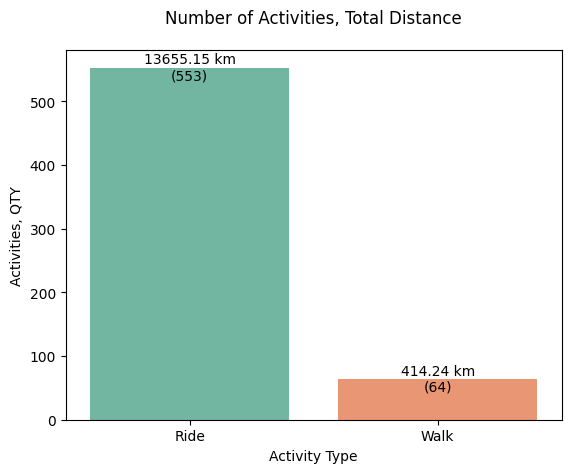

In [22]:
# activity categories

g = sns.countplot(x='Activity Type', data=df, palette="Set2")
g.set_title('Number of Activities, Total Distance', y=1.05)
g.set(ylabel='Activities, QTY')


# Merge the groupby result with the countplot data
for i, bar in enumerate(g.patches):
    g.text(
        bar.get_x() + bar.get_width() / 2,     # X position of the text
        bar.get_height() + 0,                   # Y position of the text
        # (str(grouped[i])+" km"),            # Text to be displayed (sum value)
        f'{grouped[i]} km\n({activity_counts[i]})',  # Text to be displayed (count and sum value)
        ha='center',                             # Horizontal alignment
        va='center',                             # Vertical alignment
    )

# Display the plot
plt.show()

In [23]:
df.head()

,Activity ID,Activity Date,Activity Name,Activity Type,Activity Description,Elapsed Time,Distance,Max Heart Rate,Relative Effort,Commute,Activity Gear,Filename,Athlete Weight,Bike Weight,Elapsed Time.1,Moving Time,Distance.1,Max Speed,Average Speed,Elevation Gain,Elevation Loss,Elevation Low,Elevation High,Max Grade,Average Grade,Max Cadence,Average Cadence,Max Heart Rate.1,Average Heart Rate,Average Watts,Calories,Average Temperature,Relative Effort.1,Perceived Exertion,Prefer Perceived Exertion,Perceived Relative Effort,Commute.1,From Upload,Grade Adjusted Distance,Weather Observation Time,Weather Condition,Weather Temperature,Apparent Temperature,Dewpoint,Humidity,Weather Pressure,Wind Speed,Wind Gust,Wind Bearing,Precipitation Intensity,Sunrise Time,Sunset Time,Moon Phase,Bike,Precipitation Probability,Precipitation Type,Cloud Cover,Weather Visibility,UV Index,Weather Ozone,Flagged,Avg Elapsed Speed,Dirt Distance,Media,average_speed,max_speed,moving_time,activity_date,elevation_gain
3342,6463285994,"Jan 2, 2022, 7:39:38 PM",Get to da chaaaaappaaaaahhhh!,Ride,Activity name auto generated by https://www.Ba...,3692,20.99,NaN,NaN,False,Canyon Inflite Al,activities/6871992476.fit.gz,NaN,10.0,3692.0,3153.0,20997.990234,10.278028,6.659686,76.0,67.0,-4.400000,33.000000,7.894453,0.060006,NaN,NaN,NaN,NaN,122.832634,431.831085,4.0,NaN,NaN,NaN,NaN,0.0,1.0,NaN,1.641150e+09,5.0,4.49,0.85,4.49,1.00,999.000000,4.69,9.19,239.0,0.9310,1.641107e+09,1.641133e+09,0.00,5143659.0,0.69,5.0,1.00,6141.0,0.0,332.799988,0.0,5.687429,7.000000,NaN,23.97,37.0,52 minutes and 33 seconds,2022-01-02 19:39:38,76.0
3343,6464456622,"Jan 3, 2022, 5:12:10 AM",I am running away from my responsibilities. An...,Ride,https://www.Bandok.com - Give your activities ...,1918,10.24,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6873256215.fit.gz,NaN,10.0,1918.0,1918.0,10248.910156,7.964386,5.343540,31.0,22.0,50.599998,147.600006,3.743648,0.078057,NaN,NaN,NaN,NaN,184.156799,390.000000,6.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641186e+09,5.0,4.32,0.03,4.32,1.00,996.400024,6.00,8.95,287.0,0.4036,1.641193e+09,1.641219e+09,0.04,5567028.0,0.60,5.0,1.00,3471.0,0.0,355.899994,0.0,5.343540,4767.000000,NaN,19.24,28.67,31 minutes and 58 seconds,2022-01-03 05:12:10,31.0
3344,6466969824,"Jan 3, 2022, 3:34:40 PM","Some people have no idea what they're doing, a...",Ride,https://www.Bandok.com - Give your activities ...,3080,10.61,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6875961489.fit.gz,NaN,10.0,3080.0,2362.0,10615.440430,7.631673,4.494259,32.0,32.0,9.800000,115.000000,14.218155,-0.039565,NaN,NaN,NaN,NaN,135.194229,370.000000,4.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641222e+09,5.0,4.48,0.90,3.58,0.94,997.599976,4.57,8.91,254.0,0.3824,1.641193e+09,1.641219e+09,0.04,5567028.0,0.42,5.0,1.00,16093.0,0.0,377.700012,0.0,3.446572,4861.600098,NaN,16.18,27.47,39 minutes and 22 seconds,2022-01-03 15:34:40,32.0
3345,6469567160,"Jan 4, 2022, 5:09:06 AM","The day you stop racing, is the day you win th...",Ride,https://www.Bandok.com - Give your activities ...,1950,9.46,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6878729766.fit.gz,NaN,10.0,1950.0,1713.0,9464.620117,9.262234,5.525172,36.0,29.0,22.000000,83.599998,23.230223,0.031697,NaN,NaN,NaN,NaN,197.504089,395.000000,5.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641272e+09,5.0,4.48,-0.73,4.48,1.00,995.299988,8.71,12.42,237.0,0.2484,1.641280e+09,1.641306e+09,0.08,5567028.0,0.45,5.0,0.97,16093.0,0.0,353.600006,0.0,4.853652,5083.100098,NaN,19.89,33.34,28 minutes and 33 seconds,2022-01-04 05:09:06,36.0
3346,6471805022,"Jan 4, 2022, 3:18:52 PM","To the winch, wench!",Ride,https://www.Bandok.com - Give your activities ...,2082,10.78,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6881153023.fit.gz,NaN,10.0,2082.0,2017.0,10782.900391,8.870002,5.346009,25.0,23.0,8.400000,99.199997,37.698254,-0.020403,NaN,NaN,NaN,NaN,177.334366,422.000000,4.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641308e+09,3.0,3.81,-0.77,2.61,0.92,992.700012,6.36,9.78,210.0,0.0661,1.6412

In [24]:
# number of active days
len(df.groupby([df['activity_date'].dt.date]))

323

In [25]:
# adding new column month 
df['activity_month'] = df['activity_date'].dt.month
df['activity_day'] = df['activity_date'].dt.day
df['activity_day_name'] = df['activity_date'].dt.day_name()

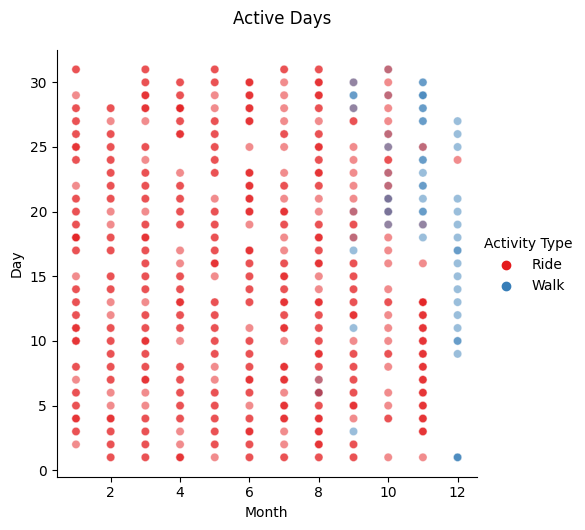

In [26]:
g = sns.relplot(x='activity_month', y='activity_day', kind='scatter',
            hue='Activity Type', alpha=.5, palette="Set1", data=df)

g.fig.suptitle('Active Days', y=1.05)

g.set(xlabel='Month', ylabel='Day')

In [27]:
df["activity_day_name"].value_counts()

activity_day_name
Tuesday      112
Thursday     102
Friday        96
Monday        95
Wednesday     94
Saturday      64
Sunday        54
Name: count, dtype: int64

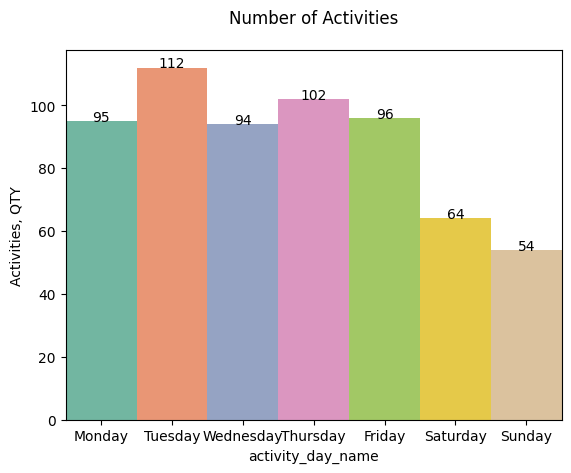

In [28]:
# Define the desired order of weekdays
weekday_order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

# Perform the groupby and get counts of activity_day_name for each weekday
day_name_counts = df["activity_day_name"].value_counts().reindex(weekday_order)


# activity categories
g = sns.countplot(x='activity_day_name', data=df, palette="Set2",order=day_name_counts.index, width=1)

g.set_title('Number of Activities', y=1.05)
g.set(ylabel='Activities, QTY')

# Merge the groupby result with the countplot data
for i, bar in enumerate(g.patches):
    g.text(
        bar.get_x() + bar.get_width() / 2,     # X position of the text
        bar.get_height() + 0,                   # Y position of the text
        # (str(grouped[i])+" km"),            # Text to be displayed (sum value)
        f'{day_name_counts[day_name_counts.index[i]]}',  # Text to be displayed (count and sum value)
        ha='center',                             # Horizontal alignment
    )

# Display the plot
plt.show()


2. MAIN ACTIVITY - RIDE


In [29]:
# Filter 'Activity Type' == 'Ride'
df_rides = df[df['Activity Type'] == 'Ride']
df_rides["Distance"].sum()

13655.15

In [30]:
df_rides.head()

,Activity ID,Activity Date,Activity Name,Activity Type,Activity Description,Elapsed Time,Distance,Max Heart Rate,Relative Effort,Commute,Activity Gear,Filename,Athlete Weight,Bike Weight,Elapsed Time.1,Moving Time,Distance.1,Max Speed,Average Speed,Elevation Gain,Elevation Loss,Elevation Low,Elevation High,Max Grade,Average Grade,Max Cadence,Average Cadence,Max Heart Rate.1,Average Heart Rate,Average Watts,Calories,Average Temperature,Relative Effort.1,Perceived Exertion,Prefer Perceived Exertion,Perceived Relative Effort,Commute.1,From Upload,Grade Adjusted Distance,Weather Observation Time,Weather Condition,Weather Temperature,Apparent Temperature,Dewpoint,Humidity,Weather Pressure,Wind Speed,Wind Gust,Wind Bearing,Precipitation Intensity,Sunrise Time,Sunset Time,Moon Phase,Bike,Precipitation Probability,Precipitation Type,Cloud Cover,Weather Visibility,UV Index,Weather Ozone,Flagged,Avg Elapsed Speed,Dirt Distance,Media,average_speed,max_speed,moving_time,activity_date,elevation_gain,activity_month,activity_day,activity_day_name
3342,6463285994,"Jan 2, 2022, 7:39:38 PM",Get to da chaaaaappaaaaahhhh!,Ride,Activity name auto generated by https://www.Ba...,3692,20.99,NaN,NaN,False,Canyon Inflite Al,activities/6871992476.fit.gz,NaN,10.0,3692.0,3153.0,20997.990234,10.278028,6.659686,76.0,67.0,-4.400000,33.000000,7.894453,0.060006,NaN,NaN,NaN,NaN,122.832634,431.831085,4.0,NaN,NaN,NaN,NaN,0.0,1.0,NaN,1.641150e+09,5.0,4.49,0.85,4.49,1.00,999.000000,4.69,9.19,239.0,0.9310,1.641107e+09,1.641133e+09,0.00,5143659.0,0.69,5.0,1.00,6141.0,0.0,332.799988,0.0,5.687429,7.000000,NaN,23.97,37.0,52 minutes and 33 seconds,2022-01-02 19:39:38,76.0,1,2,Sunday
3343,6464456622,"Jan 3, 2022, 5:12:10 AM",I am running away from my responsibilities. An...,Ride,https://www.Bandok.com - Give your activities ...,1918,10.24,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6873256215.fit.gz,NaN,10.0,1918.0,1918.0,10248.910156,7.964386,5.343540,31.0,22.0,50.599998,147.600006,3.743648,0.078057,NaN,NaN,NaN,NaN,184.156799,390.000000,6.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641186e+09,5.0,4.32,0.03,4.32,1.00,996.400024,6.00,8.95,287.0,0.4036,1.641193e+09,1.641219e+09,0.04,5567028.0,0.60,5.0,1.00,3471.0,0.0,355.899994,0.0,5.343540,4767.000000,NaN,19.24,28.67,31 minutes and 58 seconds,2022-01-03 05:12:10,31.0,1,3,Monday
3344,6466969824,"Jan 3, 2022, 3:34:40 PM","Some people have no idea what they're doing, a...",Ride,https://www.Bandok.com - Give your activities ...,3080,10.61,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6875961489.fit.gz,NaN,10.0,3080.0,2362.0,10615.440430,7.631673,4.494259,32.0,32.0,9.800000,115.000000,14.218155,-0.039565,NaN,NaN,NaN,NaN,135.194229,370.000000,4.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641222e+09,5.0,4.48,0.90,3.58,0.94,997.599976,4.57,8.91,254.0,0.3824,1.641193e+09,1.641219e+09,0.04,5567028.0,0.42,5.0,1.00,16093.0,0.0,377.700012,0.0,3.446572,4861.600098,NaN,16.18,27.47,39 minutes and 22 seconds,2022-01-03 15:34:40,32.0,1,3,Monday
3345,6469567160,"Jan 4, 2022, 5:09:06 AM","The day you stop racing, is the day you win th...",Ride,https://www.Bandok.com - Give your activities ...,1950,9.46,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6878729766.fit.gz,NaN,10.0,1950.0,1713.0,9464.620117,9.262234,5.525172,36.0,29.0,22.000000,83.599998,23.230223,0.031697,NaN,NaN,NaN,NaN,197.504089,395.000000,5.0,NaN,NaN,0.0,NaN,0.0,1.0,NaN,1.641272e+09,5.0,4.48,-0.73,4.48,1.00,995.299988,8.71,12.42,237.0,0.2484,1.641280e+09,1.641306e+09,0.08,5567028.0,0.45,5.0,0.97,16093.0,0.0,353.600006,0.0,4.853652,5083.100098,NaN,19.89,33.34,28 minutes and 33 seconds,2022-01-04 05:09:06,36.0,1,4,Tuesday
3346,6471805022,"Jan 4, 2022, 3:18:52 PM","To the winch, wench!",Ride,https://www.Bandok.com - Give your activities ...,2082,10.78,NaN,NaN,False,Canyon Grand Canyon 6.0 2018,activities/6881153023.fit.gz,NaN,10.0,2082.0,2017.0,10782.900391,8.870002,5.346009,25.0,23.0,8.400000,99.199997,37.698254,-0.020403,NaN,NaN,NaN,NaN,177.334366,422.000000,4.0,NaN,NaN,0.0,NaN

In [31]:
df_rides['Activity Type'].count()

553

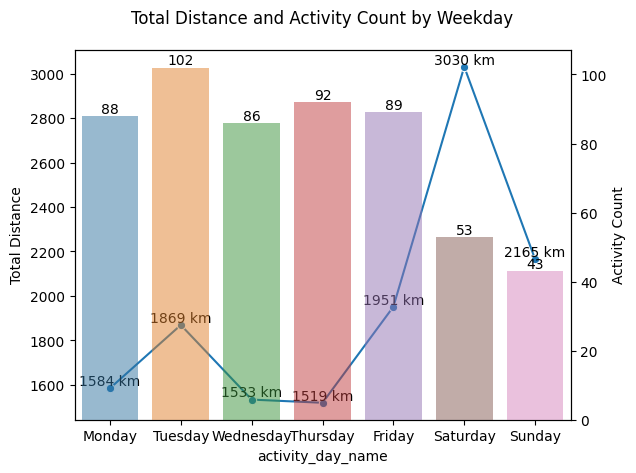

In [32]:
# Define the desired order of weekdays
weekday_order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

# Perform the groupby and get counts of activity_day_name for each weekday
day_name_counts = df_rides["activity_day_name"].value_counts().reindex(weekday_order)

# Perform the groupby and get sums of Distance for each weekday
day_name_sum = df_rides.groupby("activity_day_name")["Distance"].sum().reindex(weekday_order)

# Create the line plot
fig, ax1 = plt.subplots()
ax1.set_title('Total Distance and Activity Count by Weekday', y=1.05)
ax1.set_ylabel('Total Distance')

lineplot = sns.lineplot(x=day_name_sum.index, y=day_name_sum.values, marker="o", ax=ax1)

# Annotate line plot with sum values
for x, y in zip(day_name_sum.index, day_name_sum.values):
    lineplot.text(x, y, f'{int(y)} km', ha='center', va='bottom')

# Create the bar plot on the second axis
ax2 = ax1.twinx()
barplot = sns.barplot(x=day_name_counts.index, y=day_name_counts.values, ax=ax2, alpha=0.5)

ax2.set_ylabel('Activity Count')

# Annotate bar plot with count values
for x, y in zip(range(len(day_name_counts)), day_name_counts.values):
    barplot.text(x, y, str(y), ha='center', va='bottom')

# Display the plot
plt.show()


In [33]:
# longest distance activity based on activity type
df_rides['Distance'].max()

307.48

In [34]:
df_rides['Distance'].idxmax()

3626

Bandók

Bandók is a collection of kick-ass apps built on top of Strava. Bandok provides an app for generating clever ride names to replace the boring defaults like “Morning Ride” and an app for challenging yourself to virtual ultra-endurance cycling events.

In [35]:
# Bandók is a collection of kick-ass apps built on top of Strava. 
# Bandok provides an app for generating clever ride names to replace the boring defaults like “Morning Ride” and an app for challenging yourself to virtual ultra-endurance cycling events
df_rides['Activity Name'].head().unique()

array(['Get to da chaaaaappaaaaahhhh!',
       'I am running away from my responsibilities. And it feels good.',
       "Some people have no idea what they're doing, and a lot of them are really good at it.",
       'The day you stop racing, is the day you win the race.',
       'To the winch, wench!'], dtype=object)

In [36]:
# Elevation

elevation = df_rides[['Activity Date', 'Activity Name', 'Distance', 'moving_time', 'average_speed', 'max_speed', 'elevation_gain','Elevation Gain']].sort_values(by=['Elevation Gain'], ascending=False)
elevation.head(10)

,Activity Date,Activity Name,Distance,moving_time,average_speed,max_speed,elevation_gain,Elevation Gain
3626,"Jun 11, 2022, 5:04:09 AM","I'd Give You A Hug, But My Shirt Smells Pretty...",307.48,"12 hours, 5 minutes and 25 seconds",25.43,63.84,1422.0,1422.000000
3530,"Apr 17, 2022, 4:37:45 AM",OTHER,170.87,"8 hours, 28 minutes and 56 seconds",20.14,69.13,1139.0,1139.000000
3585,"Apr 26, 2022, 12:00:00 AM",It is not enough to have talent. You must als...,197.23,"9 hours, 51 minutes and 50 seconds",20.0,23.89,964.6,964.603333
3588,"May 21, 2022, 5:08:05 AM",Sometimes you gotta do a little bad to make good.,201.86,"7 hours, 13 minutes and 48 seconds",27.92,63.21,905.0,905.000000
3828,"Sep 25, 2022, 8:47:31 AM",Tonight I'm gonna rock you tonight.,146.06,"6 hours, 25 minutes and 47 seconds",22.72,62.69,750.0,750.000000
3778,"Aug 28, 2022, 5:25:20 AM",Taking off faster than a toupee in a fan factory.,147.10,"5 hours, 38 minutes and 57 seconds",26.04,47.05,649.0,649.000000
3666,"Jul 2, 2022, 10:55:24 AM","OK, so what's the speed of dark?",153.73,"5 hours, 37 minutes and 34 seconds",27.32,62.49,607.0,607.000000
3708,"Jul 25, 2022, 7:54:27 AM",The gang's all here. Where were you?,111.34,"4 hours, 7 minutes and 57 seconds",26.94,52.25,594.0,594.000000
3646,"Jun 22, 2022, 3:05:29 PM","Ohh, they have the internet on computers now!?",104.66,"4 hours, 2 minutes and 43 seconds",25.87,64.79,581.0,581.000000
3714,"Jul 30, 2022, 2:49:52 PM",Donuts - Is there anything they can't do?,110.29,"4 hours, 17 minutes and 17 seconds",25.72,52.91,541.0,541.000000


In [37]:
df_rides=df[df['Activity Type']=='Ride']

[Text(0.5, 0, 'Rides'), Text(0, 0.5, 'Distance (km)')]

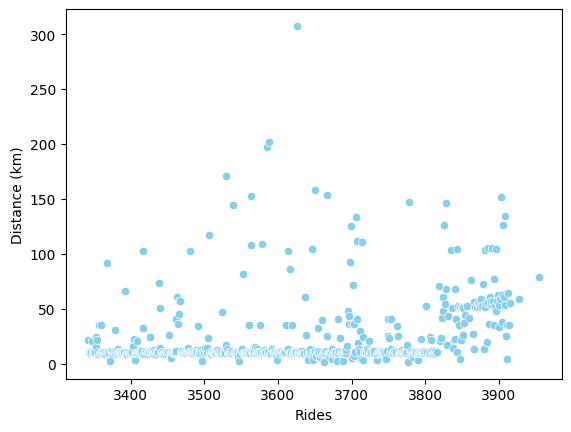

In [38]:
# Rides by Distance
g = sns.scatterplot(x=df_rides.index, y='Distance', data=df_rides, color="skyblue")
g.set(xlabel='Rides', ylabel='Distance (km)')

In [39]:
df_rides_longest=df_rides.sort_values(by=['Distance'], ascending=False)[['Activity Date', 'Activity Name', 'Activity Description', 'Distance', 'Media', 'elevation_gain', 'moving_time','Filename']].head(10)

In [40]:
df_rides_longest

,Activity Date,Activity Name,Activity Description,Distance,Media,elevation_gain,moving_time,Filename
3626,"Jun 11, 2022, 5:04:09 AM","I'd Give You A Hug, But My Shirt Smells Pretty...",Activity name auto generated by https://www.Ba...,307.48,media/0c34c96c-ad77-4fbb-ae54-31a15efd9088.jpg...,1422.0,"12 hours, 5 minutes and 25 seconds",activities/7769034226.fit.gz
3588,"May 21, 2022, 5:08:05 AM",Sometimes you gotta do a little bad to make good.,Brevetas 200 \n👏 147.3 new kilometers\n🏘 Compl...,201.86,media/f5ec7708-f941-4aa2-987e-4997809365da.jpg...,905.0,"7 hours, 13 minutes and 48 seconds",activities/7649503917.fit.gz
3585,"Apr 26, 2022, 12:00:00 AM",It is not enough to have talent. You must als...,https://www.Bandok.com - Give your activities ...,197.23,NaN,964.6,"9 hours, 51 minutes and 50 seconds",activities/7635573754.gpx.gz
3530,"Apr 17, 2022, 4:37:45 AM",OTHER,\n👏 104.11 new kilometers\n🏘 Completed 25% of...,170.87,media/0754d19a-a20f-4b7d-8228-15dcc6875081.jpg...,1139.0,"8 hours, 28 minutes and 56 seconds",activities/7448452247.fit.gz
3651,"Jun 25, 2022, 5:58:06 AM",Hold the door!,https://www.Bandok.com - Give your activities ...,157.69,media/8ab8756d-3556-4cd0-9f63-ee0ae39d4424.jpg,508.0,"4 hours, 58 minutes and 38 seconds",activities/7848725317.fit.gz
3666,"Jul 2, 2022, 10:55:24 AM","OK, so what's the speed of dark?",Activity name auto generated by https://www.Ba...,153.73,media/c2e6585c-62c7-42c3-988c-cf3ccaf3fdc9.jpg...,607.0,"5 hours, 37 minutes and 34 seconds",activities/7891527046.fit.gz
3564,"May 8, 2022, 4:51:48 AM",Don't move. Gonorrhea can't see us if we don't...,Activity name auto generated by https://www.Ba...,152.87,media/e1a974ce-da20-4b5f-9ea3-e7af2efdd028.jpg...,493.0,"6 hours, 45 minutes and 14 seconds",activities/7569592258.fit.gz
3903,"Nov 10, 2022, 3:01:55 PM","Is there like, a Texas Chainsaw movie being fi...",Activity name auto generated by https://www.Ba...,151.54,media/cdc88c82-1ea5-44e7-8269-05dfca43dce2.jpg...,402.0,"5 hours, 52 minutes and 28 seconds",activities/8670641405.fit.gz
3778,"Aug 28, 2022, 5:25:20 AM",Taking off faster than a toupee in a fan factory.,https://www.Bandok.com - Give your activities ...,147.10,media/14fc408e-9137-4fd2-ac52-d3651dde1b12.jpg...,649.0,"5 hours, 38 minutes and 57 seconds",activities/8236243018.fit.gz
3828,"Sep 25, 2022, 8:47:31 AM",Tonight I'm gonna rock you tonight.,Activity name auto generated by https://www.Ba...,146.06,media/1177e9a5-2500-43cd-9792-ca43b33f898b.jpg...,750.0,"6 hours, 25 minutes and 47 seconds",activities/8407579212.fit.gz


In [41]:
df_rides_longest.loc[3585, 'Filename']


'activities/7635573754.gpx.gz'

In [42]:

def read_file(file_path):
    _, file_extension = os.path.splitext(file_path)
    if file_extension.lower() == '.gz':
        with gzip.open(file_path, 'rb') as f:
            file_data = f.read()
    else:
        with open(file_path, 'rb') as f:
            try:
                file_data = f.read().decode('utf-8')
            except UnicodeDecodeError:
                file_data = f.read().decode('latin-1')
    return file_data   
    
    
def process_fit(file_data):
    coords = []
    fitfile = fitparse.FitFile(file_data)
    for record in fitfile.get_messages('record'):
        if record.get_value('position_lat') and record.get_value('position_long'):
            lat = record.get_value('position_lat')*(180/2**31)
            lon = record.get_value('position_long')*(180/2**31)
            coords.append((lat, lon))
    return coords
    
    
def process_gpx(file_data):
    gpx = gpxpy.parse(file_data)
    coords = []
    for track in gpx.tracks:
        for segment in track.segments:
            for point in segment.points:
                coords.append((point.latitude, point.longitude))
    return coords


for i in df_rides_longest.index:
    media_string = df_rides_longest.loc[i, 'Media']
    file_path=df_rides_longest.loc[i, 'Filename']
    
    if not isinstance(media_string, str):
        image_paths = []
    else:
        image_paths = media_string.split('|')
    activity_date = df_rides_longest.loc[i, 'Activity Date']
    activity_name = df_rides_longest.loc[i, 'Activity Name']
    activity_description = df_rides_longest.loc[i, 'Activity Description']
    distance = df_rides_longest.loc[i, 'Distance']

    show_html = f'<h3>{i} "{activity_name}" Distance: {distance} km</h3>'
    show_html += f'<p>Activity Description: {activity_description}</p>'
    show_html += f'<p>Activity Date: {activity_date}</p>'
    
    if len(image_paths) > 0:
        for path in image_paths:
            show_html += f'<a href="{path}" target="_blank"><img src="{path}" style="width:150px; margin:10px;"></a>'
    else:
        show_html += '<p>No images available.</p>'

    display(HTML(show_html))
    

    
    
    
    file_path=df_rides_longest.loc[i, 'Filename']
    file_data = read_file(file_path)

    # Process the file based on its extension
    _, file_extension = os.path.splitext(file_path)
    if file_extension.lower() == '.gz':
        # Process .gz file (GPX or FIT)
        try:
            # Try processing as fit
            
            coords = process_fit(file_data)
        except:
            # If GPX parsing fails, try processing as FIT
            coords = process_gpx(file_data)
    elif file_extension.lower() == '.gpx':
        # Process .gpx file
        coords = process_gpx(file_data)
    elif file_extension.lower() == '.fit':
        # Process .fit file
        coords = process_fit(file_data)
    else:
        print(f"Unsupported file format: {file_extension}")
        continue
   
        
            

     # Create a map centered around the first coordinate in the route
  
    center = len(coords)//4
    map_center = coords[center]
    print(map_center)
    m = folium.Map(location=map_center, zoom_start=9)

    # Add a PolyLine to the map using the coordinates
    folium.PolyLine(coords, color="blue", weight=2.5, opacity=1).add_to(m)

    # Display the map
    display(m)
    


(55.264980448409915, 24.762821244075894)


(54.822753332555294, 24.612766904756427)


(54.839902, 24.574883)


(56.07105282135308, 21.829022699967027)


(56.0025761090219, 21.209677336737514)


(55.95220925286412, 21.442762473598123)


(55.714799892157316, 21.515832468867302)


(55.98053991794586, 21.10312482342124)


(56.008856166154146, 21.252565439790487)


(55.72187840938568, 21.433360325172544)


In [43]:
df_rides_longest2 = df_rides.sort_values(by=['Distance'], ascending=False)[['Activity Date', 'Activity Name', 'Activity Description', 'Distance', 'Media', 'elevation_gain', 'moving_time','Filename']].head(50)

In [44]:
coords = []
def read_file(file_path):
    _, file_extension = os.path.splitext(file_path)
    if file_extension.lower() == '.gz':
        with gzip.open(file_path, 'rb') as f:
            file_data = f.read()
    else:
        with open(file_path, 'rb') as f:
            try:
                file_data = f.read()
            except UnicodeDecodeError:
                file_data = f.read()
    return file_data   

   
def process_fit(file_data):
    cord = []
    fitfile = fitparse.FitFile(file_data)
    for record in fitfile.get_messages('record'):
        if record.get_value('position_lat') and record.get_value('position_long'):
            lat = record.get_value('position_lat')*(180/2**31)
            lon = record.get_value('position_long')*(180/2**31)
            coord.append((lat, lon))
    return coord


    
def process_gpx(file_data):
    cord = []
    gpx = gpxpy.parse(file_data)
    for track in gpx.tracks:
        for segment in track.segments:
            for point in segment.points:
                coord.append((point.latitude, point.longitude))
    return coord
    

 
    
for i in df_rides_longest2.index:
    coord = []
    file_path = df_rides_longest2.loc[i, 'Filename']
    file_extension = os.path.splitext(file_path)[1].lower()
    file_data = read_file(file_path)

    # Process the file based on its extension

    if file_extension.lower() == '.gz':
        # Process .gz file (GPX or FIT)
        try:
            # Try processing as fit

            coord = process_fit(file_data)
        except:
            # If GPX parsing fails, try processing as FIT
            coord = process_gpx(file_data)
    elif file_extension.lower() == '.gpx':
        # Process .gpx file
        coord = process_gpx(file_data)
    elif file_extension.lower() == '.fit':
        # Process .fit file
        coord = process_fit(file_data)
    else:
        print(f"Unsupported file format: {file_extension}")
        continue
    coords.append(coord)
    

# Create the map55.47°, 22.692°
map_center = [55.47, 22.69]
m = folium.Map(location=map_center, zoom_start=7)

# Create a MultiPolyLine object and add it to the map
multi_polyline = folium.PolyLine(coords, color="green", weight=2, opacity=1).add_to(m)

# Display the map
display(m)





